In [1]:
import argparse
import glob
import itertools
import math
import os
import random
import sys

import matplotlib.animation as animation
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as transforms
import torchvision.utils as vutils
from IPython.display import HTML, clear_output
from PIL import Image
from ganetic import srgan
from sklearn.model_selection import train_test_split
from torch.autograd import Variable
from torch.utils.data import DataLoader, Dataset
from torchvision.models import vgg19
from torchvision.utils import make_grid, save_image
from tqdm import tqdm as tqdm

random.seed(42)
import warnings

warnings.filterwarnings("ignore")
from torchvision.models.vgg import vgg16

In [3]:
n_epochs = 2
dataset_path = "../input/celeba-dataset/img_align_celeba/img_align_celeba"
batch_size = 16
lr = 0.00008
b1 = 0.5
b2 = 0.999
decay_epoch = 100
n_cpu = 8
hr_height = 128
hr_width = 128
channels = 3
scale_factor = 2
cuda = torch.cuda.is_available()
mean = np.array([0.485, 0.456, 0.406])
std = np.array([0.229, 0.224, 0.225])
hr_shape = (hr_height, hr_width)

### Define Dataset Class

In [3]:
class ImageDataset(Dataset):
    def __init__(self, files, hr_shape):
        hr_height, hr_width = hr_shape
        self.lr_transform = transforms.Compose(
            [
                transforms.Resize((hr_height // scale_factor, hr_height // scale_factor), Image.BICUBIC),
                transforms.ToTensor(),
            ]
        )
        self.hr_transform = transforms.Compose(
            [
                transforms.Resize((hr_height, hr_height), Image.BICUBIC),
                transforms.ToTensor(),
            ]
        )
        self.files = files
    
    def __getitem__(self, index):
        img = Image.open(self.files[index % len(self.files)])
        img_lr = self.lr_transform(img)
        img_hr = self.hr_transform(img)

        return {"lr": img_lr, "hr": img_hr}

    def __len__(self):
        return len(self.files)

### Get Train/Test Dataloaders

In [4]:
train_paths, test_paths = train_test_split(sorted(glob.glob(dataset_path + "/*.*")), test_size=0.02, random_state=42)
train_paths, test_paths = train_paths[:3000], test_paths[:1000]
train_loader = DataLoader(ImageDataset(train_paths, hr_shape=hr_shape), batch_size=batch_size, shuffle=True, num_workers=n_cpu)
test_loader = DataLoader(ImageDataset(test_paths, hr_shape=hr_shape), batch_size=int(batch_size*0.75), shuffle=True, num_workers=n_cpu)

In [2]:
class GeneratorLoss(nn.Module):
    def __init__(self):
        super(GeneratorLoss, self).__init__()
        vgg = vgg16(pretrained=True)
        loss_network = nn.Sequential(*list(vgg.features)[:31]).eval()
        for param in loss_network.parameters():
            param.requires_grad = False
        self.loss_network = loss_network
        self.mse_loss = nn.MSELoss()
        self.tv_loss = TVLoss()

    def forward(self, out_labels, out_images, target_images):
        adversarial_loss = torch.mean(1 - out_labels)
        perception_loss = self.mse_loss(self.loss_network(out_images), self.loss_network(target_images))
        image_loss = self.mse_loss(out_images, target_images)
        tv_loss = self.tv_loss(out_images)
        return image_loss + 0.001 * adversarial_loss + 0.006 * perception_loss + 2e-8 * tv_loss


class TVLoss(nn.Module):
    def __init__(self, tv_loss_weight=1):
        super(TVLoss, self).__init__()
        self.tv_loss_weight = tv_loss_weight

    def forward(self, x):
        batch_size = x.size()[0]
        h_x = x.size()[2]
        w_x = x.size()[3]
        count_h = self.tensor_size(x[:, :, 1:, :])
        count_w = self.tensor_size(x[:, :, :, 1:])
        h_tv = torch.pow((x[:, :, 1:, :] - x[:, :, :h_x - 1, :]), 2).sum()
        w_tv = torch.pow((x[:, :, :, 1:] - x[:, :, :, :w_x - 1]), 2).sum()
        return self.tv_loss_weight * 2 * (h_tv / count_h + w_tv / count_w) / batch_size

    @staticmethod
    def tensor_size(t):
        return t.size()[1] * t.size()[2] * t.size()[3]

In [4]:
netG = srgan.Generator(scale_factor)
netD = srgan.Discriminator(input_shape=(channels, *(hr_shape)))

criterion_GAN = torch.nn.MSELoss()
generator_criterion = GeneratorLoss()

if cuda:
    netG = netG.cuda()
    netD = netD.cuda()
    criterion_GAN = criterion_GAN.cuda()
    generator_criterion = generator_criterion.cuda()

optimizer_G = torch.optim.Adam(netG.parameters(), lr=lr, betas=(b1, b2))
optimizer_D = torch.optim.Adam(netD.parameters(), lr=lr, betas=(b1, b2))

Tensor = torch.cuda.FloatTensor if cuda else torch.Tensor

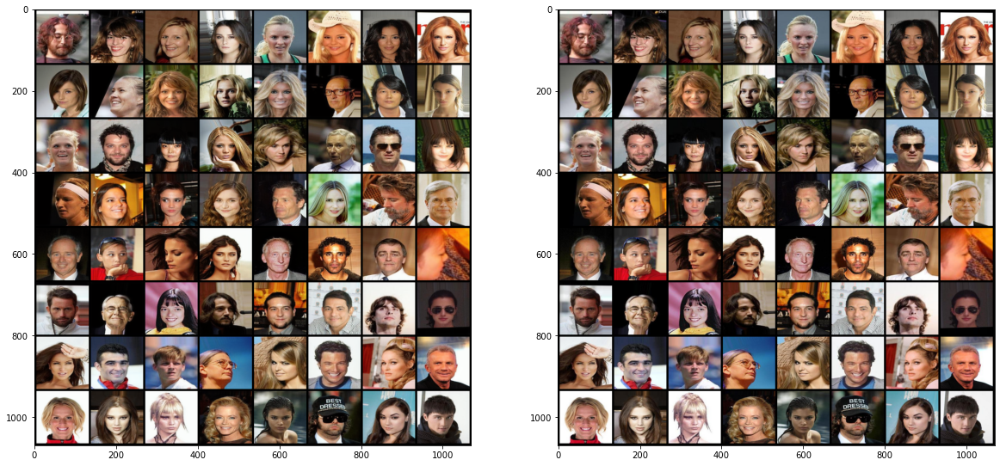

In [8]:
img_list1 = []
img_list2 = []

def display_transform():
    return transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize(400),
        transforms.CenterCrop(400),
        transforms.ToTensor()
    ])


for epoch in range(1, 100 + 1):
    train_bar = tqdm(train_loader, position=0, leave=True)
    running_results = {'batch_sizes': 0, 'd_loss': 0,
                       'g_loss': 0, 'd_score': 0, 'g_score': 0}

    netG.train()
    netD.train()
    for _data in train_bar:
        g_update_first = True
        data, target = _data['lr'], _data['hr']
        batch_size = data.shape[0]
        running_results['batch_sizes'] += batch_size


        real_img = Variable(target)
        if torch.cuda.is_available():
            real_img = real_img.cuda()
        z = Variable(data)
        if torch.cuda.is_available():
            z = z.cuda()
        fake_img = netG(z)

        netD.zero_grad()
        real_out = netD(real_img).mean()
        fake_out = netD(fake_img).mean()
        d_loss = 1 - real_out + fake_out
        d_loss.backward(retain_graph=True)
        optimizer_D.step()


        netG.zero_grad()
        fake_img = netG(z)
        fake_out = netD(fake_img).mean()
        g_loss = generator_criterion(fake_out, fake_img, real_img)
        g_loss.backward()

        fake_img = netG(z)
        fake_out = netD(fake_img).mean()

        optimizer_G.step()

        running_results['g_loss'] += g_loss.item() * batch_size
        running_results['d_loss'] += d_loss.item() * batch_size
        running_results['d_score'] += real_out.item() * batch_size
        running_results['g_score'] += fake_out.item() * batch_size

        train_bar.set_description(desc='[%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f' % (
            epoch, 100, running_results['d_loss'] /
            running_results['batch_sizes'],
            running_results['g_loss'] / running_results['batch_sizes'],
            running_results['d_score'] / running_results['batch_sizes'],
            running_results['g_score'] / running_results['batch_sizes']))

    netG.eval()
    out_path = 'training_results/SRF_' + str(4) + '/'
    if not os.path.exists(out_path):
        os.makedirs(out_path)

    with torch.no_grad():
        val_bar = tqdm(test_loader, position=0, leave=True)
        val_images = []
        ori_images = []
        for data in val_bar:
            val_lr, val_hr = data['lr'], data['hr']
            batch_size = val_lr.size(0)
            lr = val_lr
            hr = val_hr
            if torch.cuda.is_available():
                lr = lr.cuda()
                hr = hr.cuda()
            sr = netG(lr)
            val_images += sr
            ori_images += hr
        img_list1.append(vutils.make_grid(val_images[:64], padding=2, normalize=True))
        img_list2.append(vutils.make_grid(ori_images[:64], padding=2, normalize=True))
        clear_output(wait=True)
        plt.figure(figsize=(20, 20))
        plt.subplot(1, 2, 1)
        plt.imshow(np.transpose(vutils.make_grid(val_images[:64], padding=5, normalize=True).cpu(),(1,2,0)), animated=True)
        plt.subplot(1, 2, 2)
        plt.imshow(np.transpose(vutils.make_grid(ori_images[:64], padding=5, normalize=True).cpu(),(1,2,0)), animated=True)
        plt.pause(0.05)
        torch.save(netG.state_dict(), 'netG_epoch_%d.pth' % (epoch))
        torch.save(netD.state_dict(), 'netD_epoch_%d.pth' % (epoch))
        

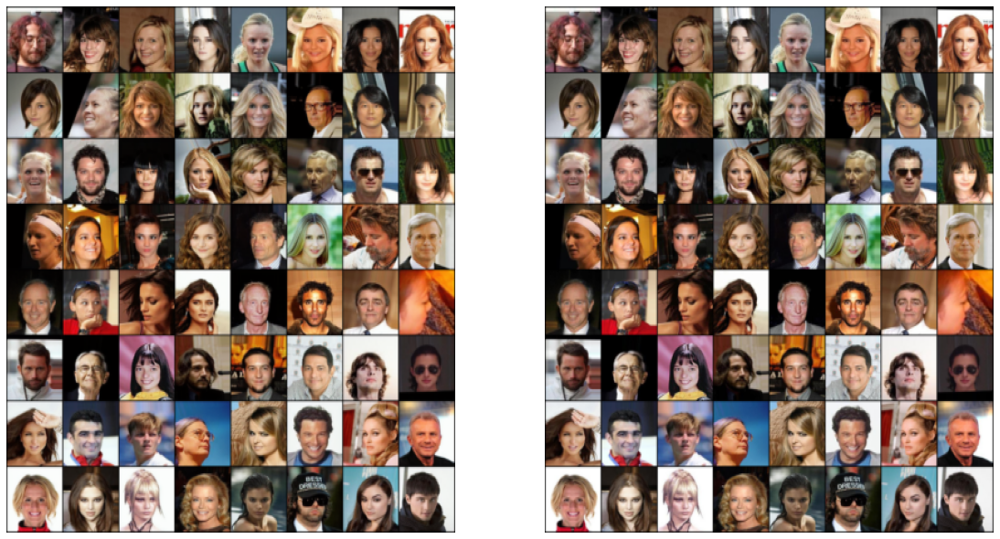

In [9]:
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(15, 8))
ims = [np.transpose(display_transform()(i).cpu(),(1,2,0)) for i in img_list1]
ims2 = [np.transpose(display_transform()(i).cpu(),(1,2,0)) for i in img_list2]
fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)
def update(frame):
    ax1.clear()
    ax2.clear()
    ax1.axis("off")
    ax2.axis('off')
    ax1.imshow(ims[frame], aspect='auto')
    ax2.imshow(ims2[frame], aspect='auto')
    
ani = animation.FuncAnimation(fig, update, frames=len(ims), interval=200)
HTML(ani.to_jshtml())